# TFM: MAPA DE PELIGROSIDAD

Lo primero que debemos hacer es descargar los datos desde una pa

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

In [2]:
dataset = pd.read_csv("../data/Crime_Data_from_2020_to_Present.csv")

In [3]:
# url = 'https://data.lacity.org/api/views/2nrs-mtv8/rows.csv?accessType=DOWNLOAD'

# dataset = pd.read_csv(url)

Para poder tener un buen conocimiento de nuestros datos debemos saber cual es el significado de cada una de las variables:

-	DR_NO : Division of Records Number: Official file number made up of a 2 digit year, area ID, and 5 digits
-	Date Rptd : MM/DD/YYYY
-	DATE OCC : MM/DD/YYYY
-	TIME OCC : In 24 hour military time.
-	AREA : The LAPD has 21 Community Police Stations referred to as Geographic Areas within the department. These Geographic Areas are sequentially numbered from 1-21.
-	AREA NAME : The 21 Geographic Areas or Patrol Divisions are also given a name designation that references a landmark or the surrounding community that it is responsible for. For example 77th Street Division is located at the intersection of South Broadway and 77th Street, serving neighborhoods in South Los Angeles.
-	Rpt Dist No : A four-digit code that represents a sub-area within a Geographic Area. All crime records reference the "RD" that it occurred in for statistical comparisons. Find LAPD Reporting Districts on the LA City GeoHub at http://geohub.lacity.org/datasets/c4f83909b81d4786aa8ba8a74a4b4db1_4
-	Part 1-2
-	Crm Cd : Indicates the crime committed. (Same as Crime Code 1)
-	Crm Cd Desc : Defines the Crime Code provided.
-	Mocodes : Modus Operandi: Activities associated with the suspect in commission of the crime.See attached PDF for list of MO Codes in numerical order. https://data.lacity.org/api/views/y8tr-7khq/files/3a967fbd-f210-4857-bc52-60230efe256c?download=true&filename=MO%20CODES%20(numerical%20order).pdf
-	Vict Age : Two character numeric
-	Vict Sex : F - Female M - Male X - Unknown
-	Vict Descent : Descent Code: A - Other Asian B - Black C - Chinese D - Cambodian F - Filipino G - Guamanian H - Hispanic/Latin/Mexican I - American Indian/Alaskan Native J - Japanese K - Korean L - Laotian O - Other P - Pacific Islander S - Samoan U - Hawaiian V - Vietnamese W - White X - Unknown Z - Asian Indian
-	Premis Cd : The type of structure, vehicle, or location where the crime took place.
-	Premis Desc : Defines the Premise Code provided.
-	Weapon Used Cd : The type of weapon used in the crime.
-	Weapon Desc : Defines the Weapon Used Code provided.
-	Status : Status of the case. (IC is the default)
-	Status Desc : Defines the Status Code provided.
-	Crm Cd 1 : Indicates the crime committed. Crime Code 1 is the primary and most serious one. Crime Code 2, 3, and 4 are respectively less serious offenses. Lower crime class numbers are more serious.
-	Crm Cd 2 : May contain a code for an additional crime, less serious than Crime Code 1.
-	Crm Cd 3 : May contain a code for an additional crime, less serious than Crime Code 1.
-	Crm Cd 4 : May contain a code for an additional crime, less serious than Crime Code 1.
-	LOCATION : Street address of crime incident rounded to the nearest hundred block to maintain anonymity.
-	Cross Street : Cross Street of rounded Address
-	LAT : Latitude
-	LON : Longtitude


In [4]:
dataset.head(10)

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,...,Status,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON
0,10304468,01/08/2020 12:00:00 AM,01/08/2020 12:00:00 AM,2230,3,Southwest,377,2,624,BATTERY - SIMPLE ASSAULT,...,AO,Adult Other,624.0,NaN,NaN,NaN,1100 W 39TH PL,NaN,34.0141,-118.2978
1,190101086,01/02/2020 12:00:00 AM,01/01/2020 12:00:00 AM,330,1,Central,163,2,624,BATTERY - SIMPLE ASSAULT,...,IC,Invest Cont,624.0,NaN,NaN,NaN,700 S HILL ST,NaN,34.0459,-118.2545
2,200110444,04/14/2020 12:00:00 AM,02/13/2020 12:00:00 AM,1200,1,Central,155,2,845,SEX OFFENDER REGISTRANT OUT OF COMPLIANCE,...,AA,Adult Arrest,845.0,NaN,NaN,NaN,200 E 6TH ST,NaN,34.0448,-118.2474
3,191501505,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,1730,15,N Hollywood,1543,2,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),...,IC,Invest Cont,745.0,998.0,NaN,NaN,5400 CORTEEN PL,NaN,34.1685,-118.4019
4,191921269,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,415,19,Mission,1998,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",...,IC,Invest Cont,740.0,NaN,NaN,NaN,14400 TITUS ST,NaN,34.2198,-118.4468
5,200100501,01/02/2020 12:00:00 AM,01/01/2020 12:00:00 AM,30,1,Central,163,1,121,"RAPE, FORCIBLE",...,IC,Invest Cont,121.0,998.0,NaN,NaN,700 S BROADWAY,NaN,34.0452,-118.2534
6,200100502,01/02/2020 12:00:00 AM,01/02/2020 12:00:00 AM,1315,1,Central,161,1,442,SHOPLIFTING - PETTY THEFT ($950 & UNDER),...,IC,Invest Cont,442.0,998.0,NaN,NaN,700 S FIGUEROA ST,NaN,34.0483,-118.2631
7,200100504,01/04/2020 12:00:00 AM,01/04/2020 12:00:00 AM,40,1,Central,155,2,946,OTHER MISCELLANEOUS CRIME,...,IC,Invest Cont,946.0,998.0,NaN,NaN,200 E 6TH ST,NaN,34.0448,-118.2474
8,200100507,01/04/2020 12:00:00 AM,01/04/2020 12:00:00 AM,200,1,Central,101,1,341,"THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LI...",...,IC,Invest Cont,341.0,998.0,NaN,NaN,700 BERNARD ST,NaN,34.0677,-118.2398
9,201710201,06/19/2020 12:00:00 AM,05/26/2020 12:00:00 AM,1925,17,Devonshire,1708,1,341,"THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LI...",...,AO,Adult Other,341.0,NaN,NaN,NaN,11900 BALBOA BL,NaN,34.2864,-118.5021


In [5]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 770787 entries, 0 to 770786
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           770787 non-null  int64  
 1   Date Rptd       770787 non-null  object 
 2   DATE OCC        770787 non-null  object 
 3   TIME OCC        770787 non-null  int64  
 4   AREA            770787 non-null  int64  
 5   AREA NAME       770787 non-null  object 
 6   Rpt Dist No     770787 non-null  int64  
 7   Part 1-2        770787 non-null  int64  
 8   Crm Cd          770787 non-null  int64  
 9   Crm Cd Desc     770787 non-null  object 
 10  Mocodes         664916 non-null  object 
 11  Vict Age        770787 non-null  int64  
 12  Vict Sex        669964 non-null  object 
 13  Vict Descent    669958 non-null  object 
 14  Premis Cd       770778 non-null  float64
 15  Premis Desc     770334 non-null  object 
 16  Weapon Used Cd  268001 non-null  float64
 17  Weapon Des

In [6]:
dataset.nunique()

DR_NO             770787
Date Rptd           1308
DATE OCC            1308
TIME OCC            1439
AREA                  21
AREA NAME             21
Rpt Dist No         1199
Part 1-2               2
Crm Cd               138
Crm Cd Desc          138
Mocodes           258897
Vict Age             103
Vict Sex               5
Vict Descent          20
Premis Cd            312
Premis Desc          306
Weapon Used Cd        79
Weapon Desc           79
Status                 6
Status Desc            6
Crm Cd 1             140
Crm Cd 2             122
Crm Cd 3              35
Crm Cd 4               6
LOCATION           62879
Cross Street        9462
LAT                 5392
LON                 4966
dtype: int64

En una primera aproximación de los datos podemos observar que tenemos 3 variables a examinar:
- La variable Crdm cd, la cual indica del 1 al 4 el nivel de peligrosidad de los datos, la cual podriamos fusionar, de alguna manera.
- La variable vict sex tiene 5 valores distintos por lo que deberemos examinar cuales son y por que, ya que solo debería tener dos, hombre y mujer.

In [7]:
# Lista de columnas en las que deseas aplicar el reemplazo
# columnas_a_modificar = ['Crm Cd 1', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4']

# Función que reemplaza los valores con 1 si tienen valor, y con 0 si no tienen valor
# dataset[columnas_a_modificar] = np.where(dataset[columnas_a_modificar].notnull(), 1, 0)

# Muestra el DataFrame modificado
# print(dataset)

#### Para tener un mejor conocimiento del dataset podemos analizar los descriptivos 

In [8]:
dataset.describe()

,DR_NO,TIME OCC,AREA,Rpt Dist No,Part 1-2,Crm Cd,Vict Age,Premis Cd,Weapon Used Cd,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LAT,LON
count,7.707870e+05,770787.000000,770787.000000,770787.000000,770787.00000,770787.000000,770787.000000,770778.000000,268001.000000,770777.000000,56971.000000,1899.000000,57.000000,770787.000000,770787.000000
mean,2.151639e+08,1334.828564,10.719168,1118.338389,1.41510,500.778896,29.897638,305.822836,362.561834,500.518718,957.348493,983.713533,990.368421,33.973516,-118.006752
std,1.046342e+07,653.978506,6.091233,609.126792,0.49274,207.903822,21.743777,216.671092,123.763859,207.694588,111.713809,51.187624,28.594225,1.846479,6.402976
min,8.170000e+02,1.000000,1.000000,101.000000,1.00000,110.000000,-3.000000,101.000000,101.000000,110.000000,210.000000,434.000000,821.000000,0.000000,-118.667600
25%,2.101054e+08,900.000000,6.000000,622.000000,1.00000,331.000000,10.000000,101.000000,309.000000,331.000000,998.000000,998.000000,998.000000,34.013300,-118.429600
50%,2.120102e+08,1415.000000,11.000000,1142.000000,1.00000,442.000000,31.000000,203.000000,400.000000,442.000000,998.000000,998.000000,998.000000,34.058400,-118.321500
75%,2.216080e+08,1900.000000,16.000000,1617.000000,2.00000,626.000000,45.000000,501.000000,400.000000,626.000000,998.000000,998.000000,998.000000,34.163100,-118.273900
max,2.399165e+08,2359.000000,21.000000,2199.000000,2.00000,956.000000,120.000000,974.000000,516.000000,956.000000,999.000000,999.000000,999.000000,34.334300,0.000000


De esta aproximación podemos concluir las siguientes observaciones:
- edad de 120 max

## Examinamos las posibles variables categóricas (con menos de 10 valores únicos)

Estas variables son:
- Vict Sex
- Part 1-2
- Status
- Status Desc
- Crdm cd 4

Empezamos estudaindo la variable Vict Sex

In [9]:
for valor in dataset['Vict Sex'].unique():
    print(valor)

F
M
X
nan
H
-


In [10]:
contador = dataset['Vict Sex'].value_counts()['H']
contador

88

In [11]:
dataset.shape

(770787, 28)

In [12]:
contador = dataset['Vict Sex'].value_counts()
contador

Vict Sex
M    319152
F    284561
X     66162
H        88
-         1
Name: count, dtype: int64

In [13]:
contador = dataset['Vict Sex'].isnull().sum()
contador

100823

In [14]:
# Número de valores distintos por variable
dataset1 = dataset[dataset['Vict Sex'] != 'H']
dataset1.info()

<class 'pandas.core.frame.DataFrame'>
Index: 770699 entries, 0 to 770786
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           770699 non-null  int64  
 1   Date Rptd       770699 non-null  object 
 2   DATE OCC        770699 non-null  object 
 3   TIME OCC        770699 non-null  int64  
 4   AREA            770699 non-null  int64  
 5   AREA NAME       770699 non-null  object 
 6   Rpt Dist No     770699 non-null  int64  
 7   Part 1-2        770699 non-null  int64  
 8   Crm Cd          770699 non-null  int64  
 9   Crm Cd Desc     770699 non-null  object 
 10  Mocodes         664828 non-null  object 
 11  Vict Age        770699 non-null  int64  
 12  Vict Sex        669876 non-null  object 
 13  Vict Descent    669870 non-null  object 
 14  Premis Cd       770690 non-null  float64
 15  Premis Desc     770246 non-null  object 
 16  Weapon Used Cd  267976 non-null  float64
 17  Weapon Desc    

In [15]:
for valor in dataset1['Vict Sex'].unique():
    print(valor)

F
M
X
nan
-


In [16]:
dataset2 = dataset1[dataset1['Vict Sex'] != '-']
dataset2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 770698 entries, 0 to 770786
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           770698 non-null  int64  
 1   Date Rptd       770698 non-null  object 
 2   DATE OCC        770698 non-null  object 
 3   TIME OCC        770698 non-null  int64  
 4   AREA            770698 non-null  int64  
 5   AREA NAME       770698 non-null  object 
 6   Rpt Dist No     770698 non-null  int64  
 7   Part 1-2        770698 non-null  int64  
 8   Crm Cd          770698 non-null  int64  
 9   Crm Cd Desc     770698 non-null  object 
 10  Mocodes         664827 non-null  object 
 11  Vict Age        770698 non-null  int64  
 12  Vict Sex        669875 non-null  object 
 13  Vict Descent    669869 non-null  object 
 14  Premis Cd       770689 non-null  float64
 15  Premis Desc     770245 non-null  object 
 16  Weapon Used Cd  267976 non-null  float64
 17  Weapon Desc    

In [17]:
for valor in dataset2['Vict Sex'].unique():
    print(valor)

F
M
X
nan


In [18]:
contador = dataset2['Vict Sex'].isnull().sum()
contador

100823

In [19]:
contador = dataset2['Vict Sex'].value_counts()
contador

Vict Sex
M    319152
F    284561
X     66162
Name: count, dtype: int64

In [20]:
import plotly.express as px
# Histograma de calificación del productor
fig = px.histogram(dataset2, x="Vict Sex") 
fig.show()

Hemos eliminado los valores H y - ya que su represenatción era mínima, sin embargo, en el caso de X deberemos determinar si está variable será determinante. Pensamos que puede ser interesante dejar este valor porque actualmente el valor 'otros' es visulizado.

<Axes: xlabel='Vict Sex', ylabel='Vict Age'>

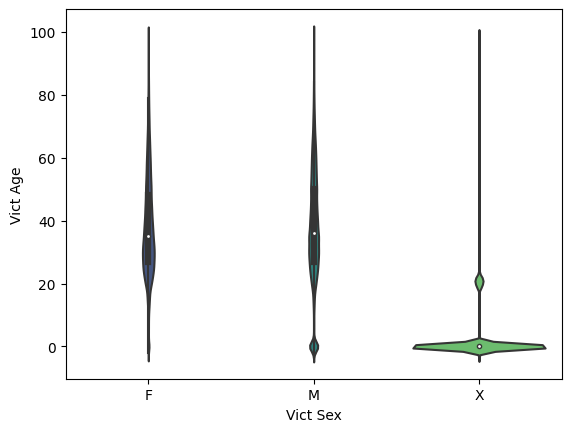

In [21]:
sns.violinplot(x='Vict Sex', y='Vict Age', data=dataset2, palette='viridis')

2. Estudiamos la variable Status y Status Desc

hacer rangos de edad

In [22]:
for valor in dataset2['Status'].unique():
    print(valor)

AO
IC
AA
JA
JO
CC


In [23]:
for valor in dataset2['Status Desc'].unique():
    print(valor)

Adult Other
Invest Cont
Adult Arrest
Juv Arrest
Juv Other
UNK


In [24]:
contador = dataset2['Status'].value_counts()
contador

Status
IC    616884
AO     82819
AA     67237
JA      2453
JO      1302
CC         3
Name: count, dtype: int64

In [25]:
contador = dataset2['Status Desc'].value_counts()
contador

Status Desc
Invest Cont     616884
Adult Other      82819
Adult Arrest     67237
Juv Arrest        2453
Juv Other         1302
UNK                  3
Name: count, dtype: int64

Podemos observar que:
- Las dos variables tienen exactamente los mismos valores y el mismo número, por lo tanto, se trata de la misma variable
- Los valores Unknown representan un pocentaje insignificante y podrán ser eliminados

In [26]:
dataset2 = dataset1[dataset1['Status Desc'] != 'UNK']
dataset2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 770696 entries, 0 to 770786
Data columns (total 28 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   DR_NO           770696 non-null  int64  
 1   Date Rptd       770696 non-null  object 
 2   DATE OCC        770696 non-null  object 
 3   TIME OCC        770696 non-null  int64  
 4   AREA            770696 non-null  int64  
 5   AREA NAME       770696 non-null  object 
 6   Rpt Dist No     770696 non-null  int64  
 7   Part 1-2        770696 non-null  int64  
 8   Crm Cd          770696 non-null  int64  
 9   Crm Cd Desc     770696 non-null  object 
 10  Mocodes         664825 non-null  object 
 11  Vict Age        770696 non-null  int64  
 12  Vict Sex        669873 non-null  object 
 13  Vict Descent    669867 non-null  object 
 14  Premis Cd       770687 non-null  float64
 15  Premis Desc     770243 non-null  object 
 16  Weapon Used Cd  267974 non-null  float64
 17  Weapon Desc    

In [27]:
dataset3 = dataset2.drop(['Status'],axis=1)

In [28]:
import plotly.express as px
# Histograma de calificación del productor
fig = px.histogram(dataset3, x="Status Desc") 
fig.show()

3. Part 1-2:

In [29]:
for valor in dataset2['Part 1-2'].unique():
    print(valor)

2
1


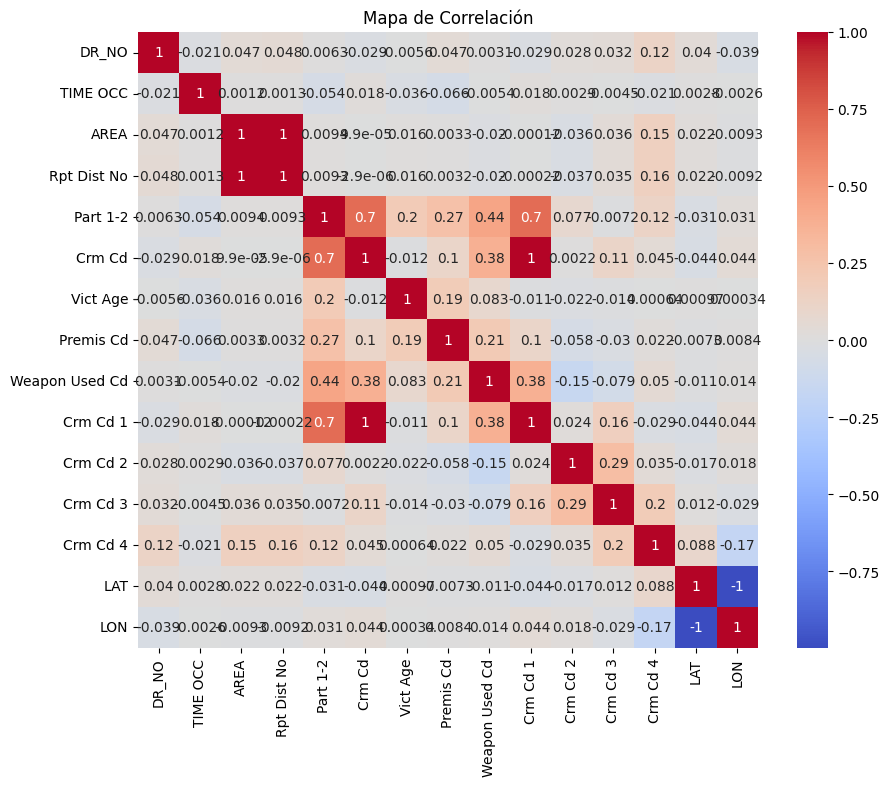

In [30]:
# Calcula la matriz de correlación
correlation_matrix = dataset3.corr(numeric_only=True)

# Crea un mapa de correlación utilizando Seaborn
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', center=0)
plt.title('Mapa de Correlación')
plt.show()

In [31]:
for valor in dataset2['Crm Cd'].unique():
    print(valor)

624
845
745
740
121
442
946
341
330
930
648
626
440
354
210
230
310
510
420
761
236
662
350
860
480
623
956
900
888
331
901
886
421
647
940
810
922
812
220
625
755
649
815
251
320
850
820
668
902
664
920
343
437
753
928
910
760
762
661
351
821
237
903
813
666
627
805
763
441
122
443
450
434
410
890
520
670
951
660
654
352
250
110
933
652
950
231
345
822
814
932
622
471
235
470
921
906
433
651
943
653
436
439
806
949
522
446
113
438
451
485
944
954
756
942
487
473
347
435
880
444
475
474
931
865
349
452
353
870
924
840
948
884
904
830
432
882
445


¿eliminamos crm cd y part 1-2?

## Pasar a factor

In [32]:
# Lista de columnas con menos de 10 valores distintos. Potenciales factores!
dataset3['Vict Sex'] = dataset3['Vict Sex'].astype('category')
dataset3['Status Desc'] = dataset3['Status Desc'].astype('category')

In [33]:
dataset3.info()
dataset3.describe()

<class 'pandas.core.frame.DataFrame'>
Index: 770696 entries, 0 to 770786
Data columns (total 27 columns):
 #   Column          Non-Null Count   Dtype   
---  ------          --------------   -----   
 0   DR_NO           770696 non-null  int64   
 1   Date Rptd       770696 non-null  object  
 2   DATE OCC        770696 non-null  object  
 3   TIME OCC        770696 non-null  int64   
 4   AREA            770696 non-null  int64   
 5   AREA NAME       770696 non-null  object  
 6   Rpt Dist No     770696 non-null  int64   
 7   Part 1-2        770696 non-null  int64   
 8   Crm Cd          770696 non-null  int64   
 9   Crm Cd Desc     770696 non-null  object  
 10  Mocodes         664825 non-null  object  
 11  Vict Age        770696 non-null  int64   
 12  Vict Sex        669873 non-null  category
 13  Vict Descent    669867 non-null  object  
 14  Premis Cd       770687 non-null  float64 
 15  Premis Desc     770243 non-null  object  
 16  Weapon Used Cd  267974 non-null  float64 
 

,DR_NO,TIME OCC,AREA,Rpt Dist No,Part 1-2,Crm Cd,Vict Age,Premis Cd,Weapon Used Cd,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LAT,LON
count,7.706960e+05,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000,770687.000000,267974.000000,770686.000000,56967.000000,1899.000000,57.000000,770696.000000,770696.000000
mean,2.151638e+08,1334.834243,10.719057,1118.327199,1.415103,500.789755,29.896859,305.819606,362.564491,500.529546,957.352204,983.713533,990.368421,33.973506,-118.006716
std,1.046351e+07,653.967920,6.091235,609.126725,0.492740,207.907013,21.744278,216.668119,123.763672,207.697771,111.708611,51.187624,28.594225,1.846587,6.403353
min,8.170000e+02,1.000000,1.000000,101.000000,1.000000,110.000000,-3.000000,101.000000,101.000000,110.000000,210.000000,434.000000,821.000000,0.000000,-118.667600
25%,2.101054e+08,900.000000,6.000000,622.000000,1.000000,331.000000,10.000000,101.000000,309.000000,331.000000,998.000000,998.000000,998.000000,34.013300,-118.429600
50%,2.120102e+08,1415.000000,11.000000,1142.000000,1.000000,442.000000,31.000000,203.000000,400.000000,442.000000,998.000000,998.000000,998.000000,34.058400,-118.321500
75%,2.216080e+08,1900.000000,16.000000,1617.000000,2.000000,626.000000,45.000000,501.000000,400.000000,626.000000,998.000000,998.000000,998.000000,34.163100,-118.273900
max,2.399165e+08,2359.000000,21.000000,2199.000000,2.000000,956.000000,120.000000,974.000000,516.000000,956.000000,999.000000,999.000000,999.000000,34.334300,0.000000


In [34]:
dataset3.describe(exclude=np.number)

,Date Rptd,DATE OCC,AREA NAME,Crm Cd Desc,Mocodes,Vict Sex,Vict Descent,Premis Desc,Weapon Desc,Status Desc,LOCATION,Cross Street
count,770696,770696,770696,770696,664825,669873,669867,770243,267974,770696,770696,123772
unique,1308,1308,21,138,258878,4,20,306,79,5,62879,9462
top,02/03/2023 12:00:00 AM,12/02/2022 12:00:00 AM,Central,VEHICLE - STOLEN,0344,M,H,STREET,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",Invest Cont,800 N ALAMEDA ST,BROADWAY
freq,922,1127,51731,82396,31787,319150,236616,194174,143858,616885,1418,2039


In [35]:
for valor in dataset2['Premis Desc'].unique():
    print(valor)

SINGLE FAMILY DWELLING
SIDEWALK
POLICE FACILITY
MULTI-UNIT DWELLING (APARTMENT, DUPLEX, ETC)
BEAUTY SUPPLY STORE
NIGHT CLUB (OPEN EVENINGS ONLY)
DEPARTMENT STORE
OTHER BUSINESS
STREET
PARKING LOT
HOTEL
COFFEE SHOP (STARBUCKS, COFFEE BEAN, PEET'S, ETC.)
ALLEY
CONDOMINIUM/TOWNHOUSE
PUBLIC RESTROOM/OUTSIDE*
GARAGE/CARPORT
MTA BUS
NURSING/CONVALESCENT/RETIREMENT HOME
MINI-MART
VEHICLE, PASSENGER/TRUCK
OTHER STORE
GROUP HOME
MTA - RED LINE - UNION STATION
RESTAURANT/FAST FOOD
MTA - RED LINE - PERSHING SQUARE
DRUG STORE
GOVERNMENT FACILITY (FEDERAL,STATE, COUNTY & CITY)
SINGLE RESIDENCE OCCUPANCY (SRO'S) LOCATIONS
PARKING UNDERGROUND/BUILDING
MOTEL
HOSPITAL
DRIVEWAY
MARKET
LA UNION STATION (NOT LINE SPECIFIC)
MISSIONS/SHELTERS
BAR/COCKTAIL/NIGHTCLUB
TOW YARD*
DETENTION/JAIL FACILITY
OTHER PREMISE
CELL PHONE STORE
CLOTHING STORE
BANK
MTA - BLUE LINE - 7TH AND METRO CENTER
OTHER/OUTSIDE
STAPLES CENTER *
CONSTRUCTION SITE
MEDICAL/DENTAL OFFICES
MTA - RED LINE - 7TH AND METRO CENTER
LIQUOR STORE

### Creamos los rangos de edad:

In [36]:
## AGE (realizamos una variable con 3 rangos de edad y 3 variables con esos mismos rangos)
dataset3['Niño'] = dataset3['Vict Age'].apply(lambda x: 1 if x<=12 else 0)
dataset3['Joven'] = dataset3['Vict Age'].apply(lambda x: 1 if x>12 and x<=26 else 0)
dataset3['Adulto'] = dataset3['Vict Age'].apply(lambda x: 1 if x>26 and x<60 else 0)
dataset3['Mayor de 60'] = dataset3['Vict Age'].apply(lambda x: 1 if x>=60 else 0)
# dataset3['Mayor de 60'] = dataset3['Vict Age'].apply(lambda x: 0 if x<=35 else (1 if x>35 and x<60 else(2)))


In [37]:
pd.set_option('display.max_columns', None)

dataset3.head()

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Niño,Joven,Adulto,Mayor de 60
0,10304468,01/08/2020 12:00:00 AM,01/08/2020 12:00:00 AM,2230,3,Southwest,377,2,624,BATTERY - SIMPLE ASSAULT,0444 0913,36,F,B,501.0,SINGLE FAMILY DWELLING,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",Adult Other,624.0,NaN,NaN,NaN,1100 W 39TH PL,NaN,34.0141,-118.2978,0,0,1,0
1,190101086,01/02/2020 12:00:00 AM,01/01/2020 12:00:00 AM,330,1,Central,163,2,624,BATTERY - SIMPLE ASSAULT,0416 1822 1414,25,M,H,102.0,SIDEWALK,500.0,UNKNOWN WEAPON/OTHER WEAPON,Invest Cont,624.0,NaN,NaN,NaN,700 S HILL ST,NaN,34.0459,-118.2545,0,1,0,0
2,200110444,04/14/2020 12:00:00 AM,02/13/2020 12:00:00 AM,1200,1,Central,155,2,845,SEX OFFENDER REGISTRANT OUT OF COMPLIANCE,1501,0,X,X,726.0,POLICE FACILITY,NaN,NaN,Adult Arrest,845.0,NaN,NaN,NaN,200 E 6TH ST,NaN,34.0448,-118.2474,1,0,0,0
3,191501505,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,1730,15,N Hollywood,1543,2,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),0329 1402,76,F,W,502.0,"MULTI-UNIT DWELLING (APARTMENT, DUPLEX, ETC)",NaN,NaN,Invest Cont,745.0,998.0,NaN,NaN,5400 CORTEEN PL,NaN,34.1685,-118.4019,0,0,0,1
4,191921269,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,415,19,Mission,1998,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",0329,31,X,X,409.0,BEAUTY SUPPLY STORE,NaN,NaN,Invest Cont,740.0,NaN,NaN,NaN,14400 TITUS ST,NaN,34.2198,-118.4468,0,0,1,0


### Valores atípicos

In [38]:
dataset3.select_dtypes(include=np.number).apply(lambda x: x.skew())

DR_NO             -0.002166
TIME OCC          -0.428290
AREA               0.009691
Rpt Dist No        0.016670
Part 1-2           0.344593
Crm Cd             0.488824
Vict Age           0.115804
Premis Cd          0.520259
Weapon Used Cd    -0.983263
Crm Cd 1           0.490002
Crm Cd 2          -3.620048
Crm Cd 3          -4.820790
Crm Cd 4          -4.550519
LAT              -18.277084
LON               18.369789
Niño               1.134168
Joven              1.927188
Adulto            -0.000296
Mayor de 60        2.792399
dtype: float64

In [39]:
dataset3[['Crm Cd 4']].nunique()

Crm Cd 4    6
dtype: int64

In [40]:
dataset['Crm Cd 1'].isnull().sum()

10

In [41]:
print(dataset3['Crm Cd 1'].value_counts(),
dataset3['Crm Cd 2'].value_counts(),
dataset3['Crm Cd 3'].value_counts(),
dataset3['Crm Cd 4'].value_counts())

Crm Cd 1
510.0    82387
624.0    61378
354.0    49514
330.0    47477
740.0    47294
         ...  
452.0        3
430.0        2
884.0        2
445.0        2
882.0        1
Name: count, Length: 140, dtype: int64 Crm Cd 2
998.0    45567
930.0     3165
860.0     1079
761.0      784
626.0      755
         ...  
942.0        1
473.0        1
943.0        1
445.0        1
450.0        1
Name: count, Length: 122, dtype: int64 Crm Cd 3
998.0    1668
930.0      79
946.0      24
910.0      23
761.0      14
740.0      13
999.0      10
901.0       6
626.0       6
860.0       6
956.0       5
653.0       5
821.0       4
745.0       4
993.0       3
997.0       3
888.0       3
820.0       3
815.0       3
753.0       2
434.0       1
906.0       1
649.0       1
943.0       1
813.0       1
940.0       1
810.0       1
648.0       1
933.0       1
830.0       1
900.0       1
763.0       1
902.0       1
990.0       1
903.0       1
Name: count, dtype: int64 Crm Cd 4
998.0    50
999.0     2
946.0     2
930.

In [42]:
dataset_prueba= dataset3[['Crm Cd','Crm Cd Desc']]
dataset_prueba

,Crm Cd,Crm Cd Desc
0,624,BATTERY - SIMPLE ASSAULT
1,624,BATTERY - SIMPLE ASSAULT
2,845,SEX OFFENDER REGISTRANT OUT OF COMPLIANCE
3,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER)
4,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA..."
...,...,...
770782,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA..."
770783,230,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT"
770784,230,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT"
770785,352,PICKPOCKET


In [43]:
dataset_ordenado = dataset_prueba.sort_values(by='Crm Cd', ascending=True)

In [44]:
dataset_ordenado

,Crm Cd,Crm Cd Desc
59646,110,CRIMINAL HOMICIDE
296327,110,CRIMINAL HOMICIDE
453804,110,CRIMINAL HOMICIDE
586142,110,CRIMINAL HOMICIDE
393381,110,CRIMINAL HOMICIDE
...,...,...
66594,956,"LETTERS, LEWD - TELEPHONE CALLS, LEWD"
650927,956,"LETTERS, LEWD - TELEPHONE CALLS, LEWD"
715715,956,"LETTERS, LEWD - TELEPHONE CALLS, LEWD"
282060,956,"LETTERS, LEWD - TELEPHONE CALLS, LEWD"


In [45]:
dataset_sin_duplicados = dataset_ordenado.drop_duplicates(subset=['Crm Cd'])


In [46]:
dataset_sin_duplicados.shape

(138, 2)

In [47]:
pd.set_option('display.max_rows', None)
dataset_sin_duplicados

,Crm Cd,Crm Cd Desc
59646,110,CRIMINAL HOMICIDE
584511,113,"MANSLAUGHTER, NEGLIGENT"
35721,121,"RAPE, FORCIBLE"
234651,122,"RAPE, ATTEMPTED"
630397,210,ROBBERY
239300,220,ATTEMPTED ROBBERY
180652,230,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT"
105895,231,ASSAULT WITH DEADLY WEAPON ON POLICE OFFICER
44243,235,CHILD ABUSE (PHYSICAL) - AGGRAVATED ASSAULT
530734,236,INTIMATE PARTNER - AGGRAVATED ASSAULT


In [48]:
dataset3['Crm Cd 1'].info()

<class 'pandas.core.series.Series'>
Index: 770696 entries, 0 to 770786
Series name: Crm Cd 1
Non-Null Count   Dtype  
--------------   -----  
770686 non-null  float64
dtypes: float64(1)
memory usage: 11.8 MB


In [49]:
dataset3.describe()

,DR_NO,TIME OCC,AREA,Rpt Dist No,Part 1-2,Crm Cd,Vict Age,Premis Cd,Weapon Used Cd,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LAT,LON,Niño,Joven,Adulto,Mayor de 60
count,7.706960e+05,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000,770687.000000,267974.000000,770686.000000,56967.000000,1899.000000,57.000000,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000
mean,2.151638e+08,1334.834243,10.719057,1118.327199,1.415103,500.789755,29.896859,305.819606,362.564491,500.529546,957.352204,983.713533,990.368421,33.973506,-118.006716,0.253357,0.153062,0.500074,0.093508
std,1.046351e+07,653.967920,6.091235,609.126725,0.492740,207.907013,21.744278,216.668119,123.763672,207.697771,111.708611,51.187624,28.594225,1.846587,6.403353,0.434934,0.360047,0.500000,0.291143
min,8.170000e+02,1.000000,1.000000,101.000000,1.000000,110.000000,-3.000000,101.000000,101.000000,110.000000,210.000000,434.000000,821.000000,0.000000,-118.667600,0.000000,0.000000,0.000000,0.000000
25%,2.101054e+08,900.000000,6.000000,622.000000,1.000000,331.000000,10.000000,101.000000,309.000000,331.000000,998.000000,998.000000,998.000000,34.013300,-118.429600,0.000000,0.000000,0.000000,0.000000
50%,2.120102e+08,1415.000000,11.000000,1142.000000,1.000000,442.000000,31.000000,203.000000,400.000000,442.000000,998.000000,998.000000,998.000000,34.058400,-118.321500,0.000000,0.000000,1.000000,0.000000
75%,2.216080e+08,1900.000000,16.000000,1617.000000,2.000000,626.000000,45.000000,501.000000,400.000000,626.000000,998.000000,998.000000,998.000000,34.163100,-118.273900,1.000000,0.000000,1.000000,0.000000
max,2.399165e+08,2359.000000,21.000000,2199.000000,2.000000,956.000000,120.000000,974.000000,516.000000,956.000000,999.000000,999.000000,999.000000,34.334300,0.000000,1.000000,1.000000,1.000000,1.000000


In [50]:
# Convertir las columnas en conjuntos y encontrar los valores distintos
valores_distintos_col1 = set(dataset['Crm Cd'])
valores_distintos_col2 = set(dataset['Crm Cd 1'])

# Encontrar los valores distintos entre las dos columnas
valores_distintos = valores_distintos_col1.symmetric_difference(valores_distintos_col2)

print("Valores distintos entre las columnas:", valores_distintos)

Valores distintos entre las columnas: {521.0, nan, nan, nan, 430.0, nan, nan, nan, nan, nan, nan, nan}


In [51]:
dataset['Crm Cd 1'].value_counts()[521]

5

In [52]:
dataset['Crm Cd 1'].value_counts()[430]

2

In [53]:
prueba2 = dataset3.drop_duplicates(subset=['Crm Cd'])


In [54]:
prueba1= dataset3.drop_duplicates(subset=['Crm Cd 2'])

In [55]:
prueba1.shape

(123, 31)

In [56]:
# Verificar los valores únicos en 'Crm Cd 2'
crm_cd_2_unique = dataset3['Crm Cd 2'].unique()

# Verificar los valores únicos en 'Crm Cd'
crm_cd_unique = dataset3['Crm Cd'].unique()

# Encontrar los valores en 'Crm Cd 2' que no están en 'Crm Cd'
valores_no_en_crm_cd = [valor for valor in crm_cd_2_unique if valor not in crm_cd_unique]

# Imprimir los valores que no están en 'Crm Cd'
print("Valores en 'Crm Cd 2' que no están en 'Crm Cd':")
print(valores_no_en_crm_cd)

Valores en 'Crm Cd 2' que no están en 'Crm Cd':
[nan, 998.0, 997.0, 980.0, 521.0, 999.0, 990.0, 996.0, 993.0, 972.0, 431.0, 979.0, 994.0, 430.0, 978.0, 976.0, 486.0, 945.0]


In [57]:
prueba2.shape


(138, 31)

In [58]:
dataset3['Crm Cd 2'].value_counts()[521.0]

14

In [59]:
##comentar si eliminamos los crm cd 2, 3 y 4!

In [60]:
dataset_sin_duplicados

,Crm Cd,Crm Cd Desc
59646,110,CRIMINAL HOMICIDE
584511,113,"MANSLAUGHTER, NEGLIGENT"
35721,121,"RAPE, FORCIBLE"
234651,122,"RAPE, ATTEMPTED"
630397,210,ROBBERY
239300,220,ATTEMPTED ROBBERY
180652,230,"ASSAULT WITH DEADLY WEAPON, AGGRAVATED ASSAULT"
105895,231,ASSAULT WITH DEADLY WEAPON ON POLICE OFFICER
44243,235,CHILD ABUSE (PHYSICAL) - AGGRAVATED ASSAULT
530734,236,INTIMATE PARTNER - AGGRAVATED ASSAULT


In [61]:
# Convertir las columnas en conjuntos y encontrar los valores distintos
valores_distintos_col3 = set(prueba1)
valores_distintos_col4 = set(prueba2)


# Encontrar los valores distintos entre las dos columnas
valores_distintos = valores_distintos_col3.symmetric_difference(valores_distintos_col4)

print("Valores distintos entre las columnas:", valores_distintos)

Valores distintos entre las columnas: set()


In [62]:
dataset3.describe()


,DR_NO,TIME OCC,AREA,Rpt Dist No,Part 1-2,Crm Cd,Vict Age,Premis Cd,Weapon Used Cd,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LAT,LON,Niño,Joven,Adulto,Mayor de 60
count,7.706960e+05,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000,770687.000000,267974.000000,770686.000000,56967.000000,1899.000000,57.000000,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000,770696.000000
mean,2.151638e+08,1334.834243,10.719057,1118.327199,1.415103,500.789755,29.896859,305.819606,362.564491,500.529546,957.352204,983.713533,990.368421,33.973506,-118.006716,0.253357,0.153062,0.500074,0.093508
std,1.046351e+07,653.967920,6.091235,609.126725,0.492740,207.907013,21.744278,216.668119,123.763672,207.697771,111.708611,51.187624,28.594225,1.846587,6.403353,0.434934,0.360047,0.500000,0.291143
min,8.170000e+02,1.000000,1.000000,101.000000,1.000000,110.000000,-3.000000,101.000000,101.000000,110.000000,210.000000,434.000000,821.000000,0.000000,-118.667600,0.000000,0.000000,0.000000,0.000000
25%,2.101054e+08,900.000000,6.000000,622.000000,1.000000,331.000000,10.000000,101.000000,309.000000,331.000000,998.000000,998.000000,998.000000,34.013300,-118.429600,0.000000,0.000000,0.000000,0.000000
50%,2.120102e+08,1415.000000,11.000000,1142.000000,1.000000,442.000000,31.000000,203.000000,400.000000,442.000000,998.000000,998.000000,998.000000,34.058400,-118.321500,0.000000,0.000000,1.000000,0.000000
75%,2.216080e+08,1900.000000,16.000000,1617.000000,2.000000,626.000000,45.000000,501.000000,400.000000,626.000000,998.000000,998.000000,998.000000,34.163100,-118.273900,1.000000,0.000000,1.000000,0.000000
max,2.399165e+08,2359.000000,21.000000,2199.000000,2.000000,956.000000,120.000000,974.000000,516.000000,956.000000,999.000000,999.000000,999.000000,34.334300,0.000000,1.000000,1.000000,1.000000,1.000000


In [63]:
dataset3.count()
#dataset3['Crm Cd 2'].value_counts()

DR_NO             770696
Date Rptd         770696
DATE OCC          770696
TIME OCC          770696
AREA              770696
AREA NAME         770696
Rpt Dist No       770696
Part 1-2          770696
Crm Cd            770696
Crm Cd Desc       770696
Mocodes           664825
Vict Age          770696
Vict Sex          669873
Vict Descent      669867
Premis Cd         770687
Premis Desc       770243
Weapon Used Cd    267974
Weapon Desc       267974
Status Desc       770696
Crm Cd 1          770686
Crm Cd 2           56967
Crm Cd 3            1899
Crm Cd 4              57
LOCATION          770696
Cross Street      123772
LAT               770696
LON               770696
Niño              770696
Joven             770696
Adulto            770696
Mayor de 60       770696
dtype: int64

In [64]:
def asignar_gravedad(valor):
    if valor in [110, 121, 235, 900, 907, 921, 860, 822]:
        return 5
    elif valor in [113, 122, 210, 220, 230, 231,236, 237, 250, 251, 354, 433, 434, 940, 942, 944,
                                           954, 956, 470, 473, 870, 845, 840, 820, 815, 814, 626, 627, 648, 805, 762, 761,
                                         760, 756, 755]:
        return 4
    elif valor in [310,330, 331, 341, 343, 345, 347, 349, 410, 420, 421, 901, 902, 435, 
                                                 903, 436, 904, 931, 943, 446, 350, 450, 946, 948, 949, 950, 951, 475, 622,
                                                865, 830, 821, 625, 624, 647, 810, 649, 763, 661, 662, 668, 740]:
        return 3
    elif valor in [320, 351, 352, 353, 432, 437, 438, 906, 924, 928, 930, 439, 932, 440, 441, 442, 
                                          443, 444, 445, 451, 452, 471,474, 480, 485, 890, 888, 487, 510, 520, 522, 882, 623,
                                          880, 850, 651, 653, 652, 654, 660, 664, 666, 670, 753, 745]:
        return 2
    elif valor in [933, 886, 884, 813, 812, 806]:
        return 1
    else:
        return 0
    
dataset3['nivel_gravedad'] = dataset3['Crm Cd'].apply(asignar_gravedad)

In [65]:
dataset3["nivel_gravedad"].value_counts()

nivel_gravedad
3    330779
2    213875
4    206954
5     14066
1      3805
0      1217
Name: count, dtype: int64

In [66]:
dataset3.head(10)

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status Desc,Crm Cd 1,Crm Cd 2,Crm Cd 3,Crm Cd 4,LOCATION,Cross Street,LAT,LON,Niño,Joven,Adulto,Mayor de 60,nivel_gravedad
0,10304468,01/08/2020 12:00:00 AM,01/08/2020 12:00:00 AM,2230,3,Southwest,377,2,624,BATTERY - SIMPLE ASSAULT,0444 0913,36,F,B,501.0,SINGLE FAMILY DWELLING,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",Adult Other,624.0,NaN,NaN,NaN,1100 W 39TH PL,NaN,34.0141,-118.2978,0,0,1,0,3
1,190101086,01/02/2020 12:00:00 AM,01/01/2020 12:00:00 AM,330,1,Central,163,2,624,BATTERY - SIMPLE ASSAULT,0416 1822 1414,25,M,H,102.0,SIDEWALK,500.0,UNKNOWN WEAPON/OTHER WEAPON,Invest Cont,624.0,NaN,NaN,NaN,700 S HILL ST,NaN,34.0459,-118.2545,0,1,0,0,3
2,200110444,04/14/2020 12:00:00 AM,02/13/2020 12:00:00 AM,1200,1,Central,155,2,845,SEX OFFENDER REGISTRANT OUT OF COMPLIANCE,1501,0,X,X,726.0,POLICE FACILITY,NaN,NaN,Adult Arrest,845.0,NaN,NaN,NaN,200 E 6TH ST,NaN,34.0448,-118.2474,1,0,0,0,4
3,191501505,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,1730,15,N Hollywood,1543,2,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),0329 1402,76,F,W,502.0,"MULTI-UNIT DWELLING (APARTMENT, DUPLEX, ETC)",NaN,NaN,Invest Cont,745.0,998.0,NaN,NaN,5400 CORTEEN PL,NaN,34.1685,-118.4019,0,0,0,1,2
4,191921269,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,415,19,Mission,1998,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",0329,31,X,X,409.0,BEAUTY SUPPLY STORE,NaN,NaN,Invest Cont,740.0,NaN,NaN,NaN,14400 TITUS ST,NaN,34.2198,-118.4468,0,0,1,0,3
5,200100501,01/02/2020 12:00:00 AM,01/01/2020 12:00:00 AM,30,1,Central,163,1,121,"RAPE, FORCIBLE",0413 1822 1262 1415,25,F,H,735.0,NIGHT CLUB (OPEN EVENINGS ONLY),500.0,UNKNOWN WEAPON/OTHER WEAPON,Invest Cont,121.0,998.0,NaN,NaN,700 S BROADWAY,NaN,34.0452,-118.2534,0,1,0,0,5
6,200100502,01/02/2020 12:00:00 AM,01/02/2020 12:00:00 AM,1315,1,Central,161,1,442,SHOPLIFTING - PETTY THEFT ($950 & UNDER),1402 2004 0344 0387,23,M,H,404.0,DEPARTMENT STORE,NaN,NaN,Invest Cont,442.0,998.0,NaN,NaN,700 S FIGUEROA ST,NaN,34.0483,-118.2631,0,1,0,0,2
7,200100504,01/04/2020 12:00:00 AM,01/04/2020 12:00:00 AM,40,1,Central,155,2,946,OTHER MISCELLANEOUS CRIME,1402 0392,0,X,X,726.0,POLICE FACILITY,NaN,NaN,Invest Cont,946.0,998.0,NaN,NaN,200 E 6TH ST,NaN,34.0448,-118.2474,1,0,0,0,3
8,200100507,01/04/2020 12:00:00 AM,01/04/2020 12:00:00 AM,200,1,Central,101,1,341,"THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LI...",1822 0344 1402,23,M,B,502.0,"MULTI-UNIT DWELLING (APARTMENT, DUPLEX, ETC)",NaN,NaN,Invest Cont,341.0,998.0,NaN,NaN,700 BERNARD ST,NaN,34.0677,-118.2398,0,1,0,0,3
9,201710201,06/19/2020 12:00:00 AM,05/26/2020 12:00:00 AM,1925,17,Devonshire,1708,1,341,"THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LI...",1300 0202 0378 0325,0,X,X,203.0,OTHER BUSINESS,NaN,NaN,Adult Other,341.0,NaN,NaN,NaN,11900 BALBOA BL,NaN,34.2864,-118.5021,1,0,0,0,3


In [67]:
dataset3["nivel_gravedad"].info()

<class 'pandas.core.series.Series'>
Index: 770696 entries, 0 to 770786
Series name: nivel_gravedad
Non-Null Count   Dtype
--------------   -----
770696 non-null  int64
dtypes: int64(1)
memory usage: 11.8 MB


In [68]:
columnas_a_eliminar = ['Crm Cd 1', 'Crm Cd 2', 'Crm Cd 3', 'Crm Cd 4' ]

# Eliminar las columnas especificadas
dataset3 = dataset3.drop(columns=columnas_a_eliminar)
dataset3.head(10)

,DR_NO,Date Rptd,DATE OCC,TIME OCC,AREA,AREA NAME,Rpt Dist No,Part 1-2,Crm Cd,Crm Cd Desc,Mocodes,Vict Age,Vict Sex,Vict Descent,Premis Cd,Premis Desc,Weapon Used Cd,Weapon Desc,Status Desc,LOCATION,Cross Street,LAT,LON,Niño,Joven,Adulto,Mayor de 60,nivel_gravedad
0,10304468,01/08/2020 12:00:00 AM,01/08/2020 12:00:00 AM,2230,3,Southwest,377,2,624,BATTERY - SIMPLE ASSAULT,0444 0913,36,F,B,501.0,SINGLE FAMILY DWELLING,400.0,"STRONG-ARM (HANDS, FIST, FEET OR BODILY FORCE)",Adult Other,1100 W 39TH PL,NaN,34.0141,-118.2978,0,0,1,0,3
1,190101086,01/02/2020 12:00:00 AM,01/01/2020 12:00:00 AM,330,1,Central,163,2,624,BATTERY - SIMPLE ASSAULT,0416 1822 1414,25,M,H,102.0,SIDEWALK,500.0,UNKNOWN WEAPON/OTHER WEAPON,Invest Cont,700 S HILL ST,NaN,34.0459,-118.2545,0,1,0,0,3
2,200110444,04/14/2020 12:00:00 AM,02/13/2020 12:00:00 AM,1200,1,Central,155,2,845,SEX OFFENDER REGISTRANT OUT OF COMPLIANCE,1501,0,X,X,726.0,POLICE FACILITY,NaN,NaN,Adult Arrest,200 E 6TH ST,NaN,34.0448,-118.2474,1,0,0,0,4
3,191501505,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,1730,15,N Hollywood,1543,2,745,VANDALISM - MISDEAMEANOR ($399 OR UNDER),0329 1402,76,F,W,502.0,"MULTI-UNIT DWELLING (APARTMENT, DUPLEX, ETC)",NaN,NaN,Invest Cont,5400 CORTEEN PL,NaN,34.1685,-118.4019,0,0,0,1,2
4,191921269,01/01/2020 12:00:00 AM,01/01/2020 12:00:00 AM,415,19,Mission,1998,2,740,"VANDALISM - FELONY ($400 & OVER, ALL CHURCH VA...",0329,31,X,X,409.0,BEAUTY SUPPLY STORE,NaN,NaN,Invest Cont,14400 TITUS ST,NaN,34.2198,-118.4468,0,0,1,0,3
5,200100501,01/02/2020 12:00:00 AM,01/01/2020 12:00:00 AM,30,1,Central,163,1,121,"RAPE, FORCIBLE",0413 1822 1262 1415,25,F,H,735.0,NIGHT CLUB (OPEN EVENINGS ONLY),500.0,UNKNOWN WEAPON/OTHER WEAPON,Invest Cont,700 S BROADWAY,NaN,34.0452,-118.2534,0,1,0,0,5
6,200100502,01/02/2020 12:00:00 AM,01/02/2020 12:00:00 AM,1315,1,Central,161,1,442,SHOPLIFTING - PETTY THEFT ($950 & UNDER),1402 2004 0344 0387,23,M,H,404.0,DEPARTMENT STORE,NaN,NaN,Invest Cont,700 S FIGUEROA ST,NaN,34.0483,-118.2631,0,1,0,0,2
7,200100504,01/04/2020 12:00:00 AM,01/04/2020 12:00:00 AM,40,1,Central,155,2,946,OTHER MISCELLANEOUS CRIME,1402 0392,0,X,X,726.0,POLICE FACILITY,NaN,NaN,Invest Cont,200 E 6TH ST,NaN,34.0448,-118.2474,1,0,0,0,3
8,200100507,01/04/2020 12:00:00 AM,01/04/2020 12:00:00 AM,200,1,Central,101,1,341,"THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LI...",1822 0344 1402,23,M,B,502.0,"MULTI-UNIT DWELLING (APARTMENT, DUPLEX, ETC)",NaN,NaN,Invest Cont,700 BERNARD ST,NaN,34.0677,-118.2398,0,1,0,0,3
9,201710201,06/19/2020 12:00:00 AM,05/26/2020 12:00:00 AM,1925,17,Devonshire,1708,1,341,"THEFT-GRAND ($950.01 & OVER)EXCPT,GUNS,FOWL,LI...",1300 0202 0378 0325,0,X,X,203.0,OTHER BUSINESS,NaN,NaN,Adult Other,11900 BALBOA BL,NaN,34.2864,-118.5021,1,0,0,0,3


In [69]:
# Calcular el coeficiente de correlación
correlacion = dataset3['Part 1-2'].corr(dataset3['nivel_gravedad'])

print(f"Coeficiente de correlación: {correlacion}")

Coeficiente de correlación: 0.15340162447486497


907 hasta 20 años de prisión secuestro
921 trafico de personas de 20 - 30 años 
922 robo de un menor de 16 meses a 3 años. leve 
924 0 a 6 meses infraccion delto leve
928 amenzas telefo del leves
930 del leves

In [70]:
#Cadena perpetua p hasta 20 años..
#delitos_interes5 = [110, 121, 235, 900, 907, 921, 860, 822]
nivel_gravedad_5 = dataset_sin_duplicados[dataset_sin_duplicados['Crm Cd'].isin([110, 121, 235, 900, 907, 921, 860, 822])]

In [71]:
# de 5 a 19
#delitos_interes4 = [113, 122, 210, 220, 230, 231,236, 237, 250, 251, 354, 433, 434, 940, 942, 944,
#                                           954, 956, 470, 473, 870, 845, 840, 820, 815, 814, 626, 627, 648, 805, 762, 761,
#                                         760, 756, 755]
nivel_gravedad_4 = dataset_sin_duplicados[dataset_sin_duplicados['Crm Cd'].isin([113, 122, 210, 220, 230, 231,236, 237, 250, 251, 354, 433, 434, 940, 942, 944,
                                           954, 956, 470, 473, 870, 845, 840, 820, 815, 814, 626, 627, 648, 805, 762, 761,
                                          760, 756, 755])]

In [72]:
#de 1 a 5

#delitos_interes3 = [310,330, 331, 341, 343, 345, 347, 349, 410, 420, 421, 901, 902, 435, 
#                                                 903, 436, 904, 931, 943, 446, 350, 450, 946, 948, 949, 950, 951, 475, 622,
#                                                865, 830, 821, 625, 624, 647, 810, 649, 763, 661, 662, 668, 740]
nivel_gravedad_3 = dataset_sin_duplicados[dataset_sin_duplicados['Crm Cd'].isin([310,330, 331, 341, 343, 345, 347, 349, 410, 420, 421, 901, 902, 435, 
                                            903, 436, 904, 931, 943, 446, 350, 450, 946, 948, 949, 950, 951, 475, 622,
                                          865, 830, 821, 625, 624, 647, 810, 649, 763, 661, 662, 668, 740])]

In [73]:
#menos de un año

#delitos_interes2 = [320, 351, 352, 353, 432, 437, 438, 906, 924, 928, 930, 439, 932, 440, 441, 442, 
 #                                         443, 444, 445, 451, 452, 471,474, 480, 485, 890, 888, 487, 510, 520, 522, 882, 623,
 #                                         880, 850, 651, 653, 652, 654, 660, 664, 666, 670, 753, 745]
nivel_gravedad_2 = dataset_sin_duplicados[dataset_sin_duplicados['Crm Cd'].isin([320, 351, 352, 353, 432, 437, 438, 906, 924, 928, 930, 439, 932, 440, 441, 442, 
                                          443, 444, 445, 451, 452, 471,474, 480, 485, 890, 888, 487, 510, 520, 522, 882, 623,
                                          880, 850, 651, 653, 652, 654, 660, 664, 666, 670, 753, 745])]

In [74]:
#Meses
#delitos_interes1 = [933, 886, 884, 813, 812, 806]
nivel_gravedad_1 = dataset_sin_duplicados[dataset_sin_duplicados['Crm Cd'].isin([933, 886, 884, 813, 812, 806])]

In [75]:
# Define un mapeo de categorías a los 5 grupos deseados
nivel_gravedad = {
    '1': 'nivel_gravedad_1',
    '2': 'nivel_gravedad_2',
    '3': 'nivel_gravedad_3',
    '4': 'nivel_gravedad_4',
    '5': 'nivel_gravedad_5'
}

# Crea una nueva columna utilizando el mapeo de categorías
dataset_sin_duplicados['nivel_gravedad'] = dataset_sin_duplicados['Crm Cd'].map(nivel_gravedad)

C:\Users\amari\AppData\Local\Temp\ipykernel_14984\2876503307.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [76]:
dataset_sin_duplicados.head()

,Crm Cd,Crm Cd Desc,nivel_gravedad
59646,110,CRIMINAL HOMICIDE,NaN
584511,113,"MANSLAUGHTER, NEGLIGENT",NaN
35721,121,"RAPE, FORCIBLE",NaN
234651,122,"RAPE, ATTEMPTED",NaN
630397,210,ROBBERY,NaN


In [77]:
dataset_sin_duplicados.drop('nivel_gravedad', axis=1, inplace=True)

C:\Users\amari\AppData\Local\Temp\ipykernel_14984\716177826.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [78]:
# Define un mapeo de categorías a los 5 grupos deseados
nivel_gravedad = {
    '1': 'nivel_gravedad_1',
    '2': 'nivel_gravedad_2',
    '3': 'nivel_gravedad_3',
    '4': 'nivel_gravedad_4',
    '5': 'nivel_gravedad_5'
}

# Crea una nueva columna utilizando el mapeo de categorías
dataset_sin_duplicados['nivel_gravedad'] = dataset_sin_duplicados['Crm Cd'].map(nivel_gravedad)

C:\Users\amari\AppData\Local\Temp\ipykernel_14984\2876503307.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [79]:
dataset_sin_duplicados['nivel_gravedad'].value_counts()

Series([], Name: count, dtype: int64)